<a href="https://colab.research.google.com/github/mkeohane01/GAN-Image-Denoising/blob/denoise-gan-dev/notebooks/train-GAN-denoise-blur.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Load Data

In [1]:
!pip install kaggle
from google.colab import files
files.upload()

# Download kaggle dataset
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/

# Small SIDD dataset
# !kaggle datasets download -d rajat95gupta/smartphone-image-denoising-dataset

# Blurred Image Pairs
!kaggle datasets download -d kwentar/blur-dataset

# Medium dataset
#!kaggle datasets download -d soumikrakshit/smartphone-image-denoising-dataset

Saving kaggle.json to kaggle.json
 99% 1.47G/1.49G [00:17<00:00, 111MB/s] 
100% 1.49G/1.49G [00:17<00:00, 90.5MB/s]


In [2]:
# Unzip the smartphone denoising dataset
# !unzip '/content/smartphone-image-denoising-dataset.zip'

!unzip '/content/blur-dataset.zip'

Archive:  /content/blur-dataset.zip
  inflating: blur_dataset_scaled/defocused_blurred/0_IPHONE-SE_F.JPG  
  inflating: blur_dataset_scaled/defocused_blurred/100_NIKON-D3400-35MM_F.JPG  
  inflating: blur_dataset_scaled/defocused_blurred/101_NIKON-D3400-35MM_F.JPG  
  inflating: blur_dataset_scaled/defocused_blurred/102_NIKON-D3400-35MM_F.JPG  
  inflating: blur_dataset_scaled/defocused_blurred/103_HUAWEI-P20_F.jpg  
  inflating: blur_dataset_scaled/defocused_blurred/104_IPHONE-SE_F.jpg  
  inflating: blur_dataset_scaled/defocused_blurred/105_IPHONE-SE_F.jpg  
  inflating: blur_dataset_scaled/defocused_blurred/106_NIKON-D3400-35MM_F.JPG  
  inflating: blur_dataset_scaled/defocused_blurred/107_XIAOMI-MI8-SE_F.jpg  
  inflating: blur_dataset_scaled/defocused_blurred/108_XIAOMI-MI8-SE_F.jpg  
  inflating: blur_dataset_scaled/defocused_blurred/109_HONOR-7X_F.jpg  
  inflating: blur_dataset_scaled/defocused_blurred/10_ASUS-ZENFONE-LIVE-ZB501KL_F.jpg  
  inflating: blur_dataset_scaled/defocu

## Imports

In [3]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToTensor
from PIL import Image
from sklearn.model_selection import train_test_split
from torchvision import transforms as T
from skimage.metrics import structural_similarity as ssim
import numpy as np
import cv2
from math import log10, sqrt
import matplotlib.pyplot as plt
import random
from scipy.linalg import sqrtm

## Define Model

In [54]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=9, stride=1, padding=4)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)

        self.res1 = ResidualBlock(128)
        self.res2 = ResidualBlock(128)
        self.res3 = ResidualBlock(128)

        # Adeconvolution layers
        self.deconv1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, output_padding=0)
        self.deconv2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, output_padding=0)

        # conv layers
        self.conv5 = nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1)
        self.conv6 = nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1)

        self.conv4 = nn.Conv2d(32, 3, kernel_size=9, stride=1, padding=4)

    def forward(self, x):
        input = x
        x_1 = F.relu(self.conv1(x))
        # print(f'x1 size {x_1.shape}')
        x = F.relu(self.conv2(x_1))
        # print(f'x2 size {x.shape}')
        x = F.relu(self.conv3(x))
        # print(f'x3 size {x.shape}')

        x = self.res1(x)
        # print(f'x4 - res1 size {x.shape}')
        x = self.res2(x)
        # print(f'x5 - res2 size {x.shape}')
        x = self.res3(x)
        # print(f'x6 - res3 size {x.shape}')

        # x = F.relu(self.deconv1(x))
        # print(f'x7 - deconv1 size {x.shape}')
        # x = F.relu(self.deconv2(x))
        # print(f'x8 - deconv2 size {x.shape}')

        x = F.relu(self.conv5(x))
        # print(f'x7 - conv5 size {x.shape}')
        x = F.relu(self.conv6(x))
        # print(f'x8 - conv6 size {x.shape}')

        # Ensure the sizes match for the skip connection from the first conv layer to the last deconv layer output
        # After skip connection
        x = x + x_1
        # print(f'Range after skip connection: Min {torch.min(x).item()} Max {torch.max(x).item()}')

        # After tanh
        x = torch.tanh(self.conv4(x))
        # print(f'Range after tanh: Min {torch.min(x).item()} Max {torch.max(x).item()}')

        # After final residual connection
        input_rescaled = (input * 2) - 1
        x = x + input_rescaled
        # print(f'Range after final residual connection: Min {torch.min(x).item()} Max {torch.max(x).item()}')

        # After sigmoid
        # x = torch.sigmoid(x)
        # print(f'Range after sigmoid: Min {torch.min(x).item()} Max {torch.max(x).item()}')

        return (x + 1) / 2


class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(channels)
        self.conv2 = nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(channels)

    def forward(self, x):
        residual = x
        x = F.relu(self.bn1(self.conv1(x)))
        x = self.bn2(self.conv2(x))
        x = x + residual  # Residual connection
        return x

class Discriminator(nn.Module):
  def __init__(self):
      super(Discriminator, self).__init__()
      self.conv1 = nn.Conv2d(3, 48, kernel_size=4, stride=2, padding=1)
      self.conv2 = nn.Conv2d(48, 96, kernel_size=4, stride=2, padding=1)
      self.conv3 = nn.Conv2d(96, 192, kernel_size=4, stride=2, padding=1)
      self.conv4 = nn.Conv2d(192, 384, kernel_size=4, stride=1, padding=1)
      self.conv5 = nn.Conv2d(384, 1, kernel_size=4, stride=1, padding=1)

  def forward(self, x):
      x = F.leaky_relu(self.conv1(x), 0.2)
      x = F.leaky_relu(self.conv2(x), 0.2)
      x = F.leaky_relu(self.conv3(x), 0.2)
      x = F.leaky_relu(self.conv4(x), 0.2)
      x = torch.sigmoid(self.conv5(x))
      return x

In [55]:
preprocess_transform = T.Compose([
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406],
                [0.229, 0.224, 0.225]),
    T.Resize((512, 512)),
])

postprocess_transform = T.Compose([
    T.Resize((256, 256)),
    T.ToPILImage(),
])

# Function to load image pairs from a folder
def load_image_pairs(folder, dataset="blur"):
    if dataset == "blur":
      gt_img_paths = []
      noisy_img_paths = []
      sharp_dir = os.path.join(folder, "sharp")
      blurred_dir = os.path.join(folder, "defocused_blurred")

      # Get all the file names in the sharp directory
      sharp_files = [os.path.join(sharp_dir, fname) for fname in os.listdir(sharp_dir)]

      # Get all the file names in the defocused_blurred directory
      blurred_files = [os.path.join(blurred_dir, fname) for fname in os.listdir(blurred_dir)]

      # sort both
      sharp_files.sort()
      blurred_files.sort()
      return sharp_files, blurred_files
    else:
      gt_images = []
      noisy_images = []
      for root, _, files in os.walk(folder):
          for file in files:
              if 'GT' in file:
                  gt_images.append(os.path.join(root, file))
              elif 'NOISY' in file:
                  noisy_images.append(os.path.join(root, file))
      return gt_images, noisy_images


class ImagePairDataset(Dataset):
    def __init__(self, sharp_image_paths, noisy_image_paths, transform=None):
        """
        Args:
            sharp_image_paths (list of str): Paths to the sharp images.
            noisy_image_paths (list of str): Paths to the noisy images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        assert len(noisy_image_paths) == len(sharp_image_paths), "The number of noisy and sharp images must be the same."
        self.noisy_image_paths = noisy_image_paths
        self.sharp_image_paths = sharp_image_paths
        self.transform = transform

    def __len__(self):
        return len(self.noisy_image_paths)

    def __getitem__(self, idx):
        noisy_image = Image.open(self.noisy_image_paths[idx]).convert('RGB')
        sharp_image = Image.open(self.sharp_image_paths[idx]).convert('RGB')

        if self.transform:
            noisy_image = self.transform(noisy_image)
            sharp_image = self.transform(sharp_image)

        return sharp_image, noisy_image


In [56]:
# Function to compute PSNR
def calculate_psnr(true_image, denoised_image):
    mse = np.mean((true_image - denoised_image) ** 2)
    if mse == 0:  # MSE is zero means no noise is present in the signal.
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

# Function to compute SSIM
def calculate_ssim(true_image, denoised_image):
    ssim_value = ssim(true_image, denoised_image, channel_axis=2)
    return ssim_value

def postprocess_tensor(image_tensor):
    # Denormalize using the mean and std used for normalization
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    image_tensor = image_tensor.detach().squeeze(0)  # Remove batch dimension
    image_np = image_tensor.numpy().transpose((1, 2, 0))  # Convert to (H, W, C)
    image_np = std * image_np + mean  # Denormalize
    image_np = np.clip(image_np, 0, 1)  # Ensure values are within [0, 1]
    image_np = (image_np * 255).astype(np.uint8)  # Convert to [0, 255] uint8
    return image_np


def display_images_and_calc_metrics(noisy_image, denoised_image, true_image, display=True):
    # Display the images
    if display:
      fig, axs = plt.subplots(1, 3, figsize=(15, 5))
      axs[0].imshow(noisy_image)
      axs[0].set_title('Noisy Image')
      axs[0].axis('off')

      axs[1].imshow(denoised_image)
      axs[1].set_title('Denoised Image')
      axs[1].axis('off')

      axs[2].imshow(true_image)
      axs[2].set_title('True Image')
      axs[2].axis('off')

      plt.show()

    # Calculate and print metrics
    # Ensure images are numpy arrays for metric calculations
    true_image_np = np.array(true_image)
    denoised_image_np = np.array(denoised_image)
    noisy_image_np = np.array(noisy_image)

    psnr_value = calculate_psnr(true_image_np, noisy_image_np)
    ssim_value = calculate_ssim(true_image, noisy_image)
    print(f"Noisy PSNR: {psnr_value:.2f}")
    print(f"Noisy SSIM: {ssim_value:.4f}")
    denoised_psnr = calculate_psnr(true_image_np, denoised_image_np)
    denoised_ssim = calculate_ssim(true_image_np, denoised_image_np)
    print(f"Gen PSNR: {denoised_psnr}")
    print(f"Gen SSIM: {denoised_ssim}")

    return psnr_value, ssim_value, denoised_psnr, denoised_ssim

def calculate_fid(real_features, gen_features):
    # Calculate mean and covariance statistics
    mu1, sigma1 = real_features.mean(axis=0), np.cov(real_features, rowvar=False)
    mu2, sigma2 = gen_features.mean(axis=0), np.cov(gen_features, rowvar=False)

    # Calculate sum squared difference between means
    ssdiff = np.sum((mu1 - mu2)**2.0)

    # Compute sqrt of product between cov
    covmean = sqrtm(sigma1.dot(sigma2))

    # Check and correct imaginary numbers from sqrt
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    # Calculate FID
    fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

In [57]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
## Display images and test scores
gt_images, noisy_images = load_image_pairs("/content/blur_dataset_scaled")
print(gt_images[0:10])
print(noisy_images[0:10])
dataset = ImagePairDataset(gt_images, noisy_images, preprocess_transform)
dataloader = DataLoader(dataset, batch_size=2, shuffle=True)

# gen = Generator()
# gen.load_state_dict(torch.load("/content/generator.pth", map_location=device))
# gen.eval()
for gt, noisy in dataloader:
  for i in range(gt.size(0)):
    gt_image = gt[i]
    noisy_image = noisy[i]
    gt = postprocess_tensor(gt_image)
    # Generate denoised image
    # gen_image = gen(noisy)
    gen_image = gt
    gen_image = postprocess_tensor(gen_image)
    noisy = postprocess_tensor(noisy_image)
    # Display the images
    display_images_and_calc_metrics(noisy, gen_image, gt)
    break


['/content/blur_dataset_scaled/sharp/0_IPHONE-SE_S.JPG', '/content/blur_dataset_scaled/sharp/100_NIKON-D3400-35MM_S.JPG', '/content/blur_dataset_scaled/sharp/101_NIKON-D3400-35MM_S.JPG', '/content/blur_dataset_scaled/sharp/102_NIKON-D3400-35MM_S.JPG', '/content/blur_dataset_scaled/sharp/103_HUAWEI-P20_S.jpg', '/content/blur_dataset_scaled/sharp/104_IPHONE-SE_S.jpg', '/content/blur_dataset_scaled/sharp/105_IPHONE-SE_S.jpg', '/content/blur_dataset_scaled/sharp/106_NIKON-D3400-35MM_S.JPG', '/content/blur_dataset_scaled/sharp/107_XIAOMI-MI8-SE_S.jpg', '/content/blur_dataset_scaled/sharp/108_XIAOMI-MI8-SE_S.jpg']
['/content/blur_dataset_scaled/defocused_blurred/0_IPHONE-SE_F.JPG', '/content/blur_dataset_scaled/defocused_blurred/100_NIKON-D3400-35MM_F.JPG', '/content/blur_dataset_scaled/defocused_blurred/101_NIKON-D3400-35MM_F.JPG', '/content/blur_dataset_scaled/defocused_blurred/102_NIKON-D3400-35MM_F.JPG', '/content/blur_dataset_scaled/defocused_blurred/103_HUAWEI-P20_F.jpg', '/content/blu

AttributeError: 'numpy.ndarray' object has no attribute 'detach'

In [58]:
# Function to train the SRGAN model
def train_denoising_gan(generator, discriminator, train_loader, val_loader, criterion_g, criterion_d, optimizer_g, optimizer_d, num_epochs=10, device='cuda'):
    # Loop through each epoch
    for epoch in range(num_epochs):
        # Set both the generator and discriminator to training mode
        generator.train()
        discriminator.train()

        # Initialize running losses for both generator and discriminator
        running_loss_g = 0.0
        running_loss_d = 0.0

        # Loop through the dataset
        for i, (gt_image, noisy_image) in enumerate(train_loader):
            # Move images to the appropriate device (GPU or CPU)
            gt_image = gt_image.to(device)
            noisy_image = noisy_image.to(device)

            # Zero the gradients for both optimizers
            optimizer_g.zero_grad()
            optimizer_d.zero_grad()

            # Generate super-resolved images from noisy images
            gen_image = generator(noisy_image)
            # print(gen_image.shape)


            # Train the discriminator
            # Discriminator's goal is to distinguish between real (gt_image) and fake (sr_image) images

            # Calculate discriminator loss on real images
            real_output = discriminator(gt_image.detach())
            loss_d_real = criterion_d(real_output, torch.ones_like(real_output))

            # Calculate discriminator loss on fake images
            fake_output = discriminator(gen_image.detach())  # Detach to avoid training G on these labels
            loss_d_fake = criterion_d(fake_output, torch.zeros_like(fake_output))

            # Total discriminator loss
            loss_d = (loss_d_real + loss_d_fake) / 2

            # Backpropagation for discriminator
            loss_d.backward()
            optimizer_d.step()

            # Train the generator
            # Generator's goal is to fool the discriminator into thinking the generated images are real

            # Calculate generator loss
            output = discriminator(gen_image.detach())
            loss_g = criterion_g(output, torch.ones_like(output)) + criterion_g(gen_image, gt_image)

            # Backpropagation for generator
            loss_g.backward()
            optimizer_g.step()

            # Update running losses
            running_loss_g += loss_g.item() * noisy_image.size(0)
            running_loss_d += loss_d.item() * noisy_image.size(0)

            # Print progress
            if i % 5 == 0:
              print(f'Epoch {epoch+1}/{num_epochs}, Batch {i}/{len(train_loader)}, Loss D: {loss_d.item():.4f}, Loss G: {loss_g.item():.4f}')


        # Calculate average losses for the current epoch
        epoch_loss_g = running_loss_g / len(train_loader.dataset)
        epoch_loss_d = running_loss_d / len(train_loader.dataset)

        # Print losses for the current epoch
        print(f'Train - Epoch {epoch+1}/{num_epochs}, Generator Loss: {epoch_loss_g:.4f}, Discriminator Loss: {epoch_loss_d:.4f}')

        # Compute metrics on validation set
        eval_metrics = []
        with torch.no_grad():
          generator.eval()

          for n, (gt_images, noisy_images) in enumerate(val_loader):
            for i in range(gt_images.size(0)):
              gt_imag = gt_images[i]
              noisy_img = noisy_images[i].to(device)
              gt = postprocess_tensor(gt_imag)
              # Generate denoised image
              gen_img = generator(noisy_img.unsqueeze(0))
              gen_image = postprocess_tensor(gen_img.cpu())
              noisy = postprocess_tensor(noisy_img.cpu())
              # Display the images
              display = False
              if n % 10 == 0:
                display = True
              metrics = display_images_and_calc_metrics(noisy, gen_image, gt, display=display)
              eval_metrics.append(metrics)

    return generator, discriminator, eval_metrics

In [59]:
# Main function to load data, train model, and compute metrics
def main(train_folder, num_epochs=5, device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') ):

    print(f'Using device: {device}')

    # Load image pairs
    gt_images, noisy_images = load_image_pairs(train_folder)

    # split to train and val
    noisy_train_images, noisy_val_images = train_test_split(noisy_images, test_size=0.2, random_state=42)
    gt_train_images, gt_val_images = train_test_split(gt_images, test_size=0.2, random_state=42)
    print(f'Number of training images: {len(gt_train_images)}')
    print(f'Number of validation images: {len(noisy_val_images)}')

    # Create dataset
    train_set = ImagePairDataset(gt_train_images, noisy_train_images, transform=preprocess_transform)
    val_set = ImagePairDataset(gt_val_images, noisy_val_images, transform=preprocess_transform)

    # Create data loaders
    train_loader = DataLoader(train_set, batch_size=4, shuffle=True)
    val_loader = DataLoader(val_set, batch_size=2, shuffle=False)

    # Initialize model
    gen = Generator().to(device)
    disc = Discriminator().to(device)
    # print(gen)
    # print(disc)

    # Define loss function and optimizer
    criterion_g = nn.MSELoss() # minimize difference between generated and real images
    criterion_d = nn.BCEWithLogitsLoss()  # For discriminator, to classify between real and fake images

    # Optimizers for generator and discriminator
    optimizer_g = optim.Adam(gen.parameters(), lr=0.0002, betas=(0.5, 0.999))
    optimizer_d = optim.Adam(disc.parameters(), lr=0.0002, betas=(0.5, 0.999))

    # Train the model
    generator, discriminator, eval_metrics = train_denoising_gan(gen, disc, train_loader, val_loader, criterion_g, criterion_d, optimizer_g, optimizer_d, num_epochs, device=device)

    # Save model
    torch.save(generator.state_dict(), 'generator.pth')
    print(f'Model saved to generator.pth')
    torch.save(discriminator.state_dict(), 'discriminator.pth')
    print(f'Model saved to discriminator.pth')

    eval_metrics = np.array(eval_metrics)
    print(f'Mean PSNR Input: {np.mean(eval_metrics[:, 0]):.4f}')
    print(f'Mean SSIM Input: {np.mean(eval_metrics[:, 1]):.4f}')
    print(f'Mean PSNR Gen: {np.mean(eval_metrics[:, 2]):.4f}')
    print(f'Mean RMSE Gen: {np.mean(eval_metrics[:, 3]):.4f}')

    # save metric array to csv
    np.savetxt('metrics.csv', eval_metrics, delimiter=',')
    print(f'Metrics saved to metrics.csv')



Using device: cuda
Number of training images: 280
Number of validation images: 70
Epoch 1/5, Batch 0/70, Loss D: 0.7243, Loss G: 1.5616
Epoch 1/5, Batch 5/70, Loss D: 0.7176, Loss G: 1.3813
Epoch 1/5, Batch 10/70, Loss D: 0.6932, Loss G: 1.7718
Epoch 1/5, Batch 15/70, Loss D: 0.6932, Loss G: 1.9435
Epoch 1/5, Batch 20/70, Loss D: 0.6932, Loss G: 1.8240
Epoch 1/5, Batch 25/70, Loss D: 0.6932, Loss G: 1.6050
Epoch 1/5, Batch 30/70, Loss D: 0.6932, Loss G: 1.7545
Epoch 1/5, Batch 35/70, Loss D: 0.6932, Loss G: 1.6720
Epoch 1/5, Batch 40/70, Loss D: 0.6932, Loss G: 1.9668
Epoch 1/5, Batch 45/70, Loss D: 0.6932, Loss G: 1.7123
Epoch 1/5, Batch 50/70, Loss D: 0.6932, Loss G: 1.8792
Epoch 1/5, Batch 55/70, Loss D: 0.6932, Loss G: 1.7233
Epoch 1/5, Batch 60/70, Loss D: 0.6932, Loss G: 1.4542
Epoch 1/5, Batch 65/70, Loss D: 0.6931, Loss G: 1.7022
Train - Epoch 1/5, Generator Loss: 1.6955, Discriminator Loss: 0.6955


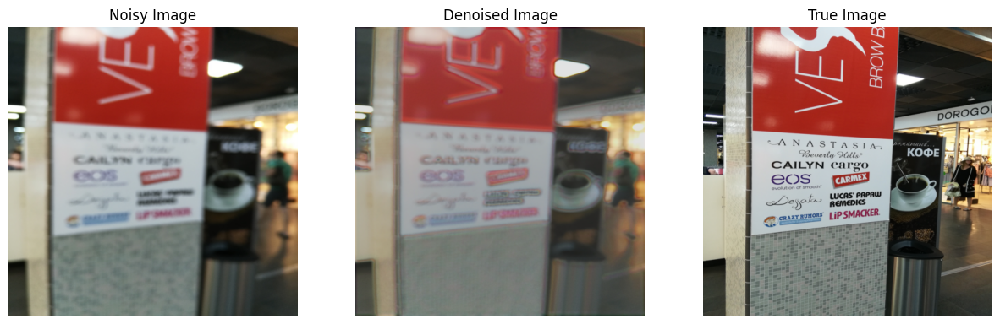

Noisy PSNR: 28.84
Noisy SSIM: 0.3825
Gen PSNR: 27.972470097021084
Gen SSIM: 0.3881336226535666


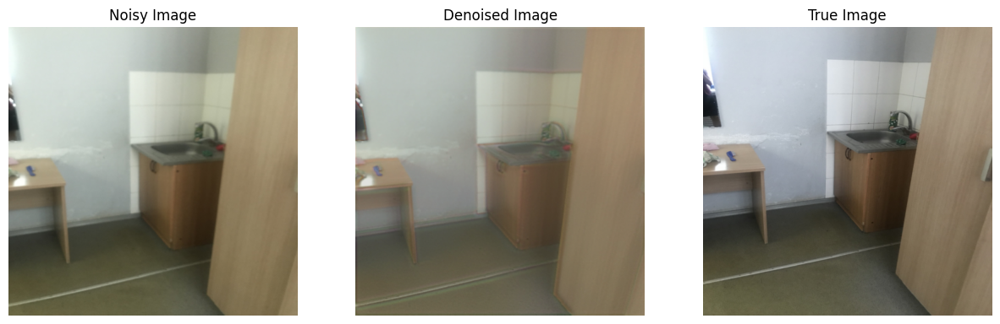

Noisy PSNR: 29.17
Noisy SSIM: 0.7758
Gen PSNR: 28.56919418603409
Gen SSIM: 0.7822316651466051
Noisy PSNR: 28.28
Noisy SSIM: 0.3978
Gen PSNR: 27.91528495378635
Gen SSIM: 0.4368896625037835
Noisy PSNR: 27.80
Noisy SSIM: 0.5134
Gen PSNR: 28.125978384537014
Gen SSIM: 0.5531010086215578
Noisy PSNR: 28.55
Noisy SSIM: 0.2449
Gen PSNR: 27.924658600284022
Gen SSIM: 0.24021514081379455
Noisy PSNR: 28.11
Noisy SSIM: 0.5435
Gen PSNR: 28.14316660051884
Gen SSIM: 0.5495838302639061
Noisy PSNR: 28.09
Noisy SSIM: 0.1732
Gen PSNR: 27.830985180320596
Gen SSIM: 0.16567138687146601
Noisy PSNR: 28.34
Noisy SSIM: 0.6133
Gen PSNR: 28.486885036529294
Gen SSIM: 0.6398475796790781
Noisy PSNR: 28.39
Noisy SSIM: 0.4136
Gen PSNR: 27.845178498999147
Gen SSIM: 0.38996840177768055
Noisy PSNR: 27.89
Noisy SSIM: 0.6561
Gen PSNR: 28.258036830878652
Gen SSIM: 0.6724625159099503
Noisy PSNR: 28.04
Noisy SSIM: 0.6855
Gen PSNR: 27.731375688287354
Gen SSIM: 0.6977521084895718
Noisy PSNR: 28.78
Noisy SSIM: 0.5887
Gen PSNR: 27.

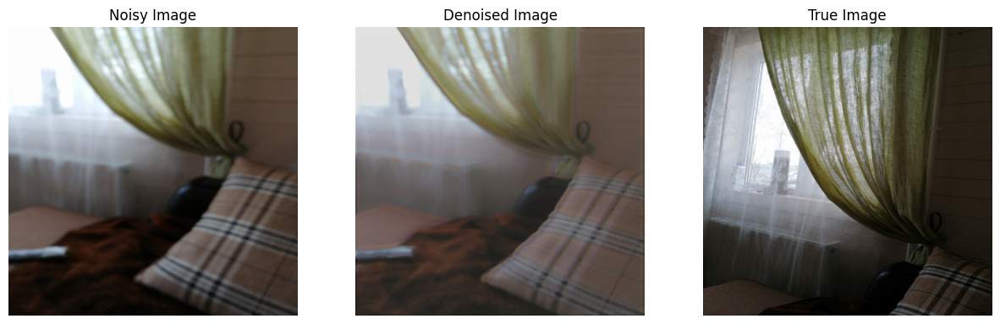

Noisy PSNR: 27.89
Noisy SSIM: 0.3727
Gen PSNR: 27.846484382690257
Gen SSIM: 0.41255103247978697


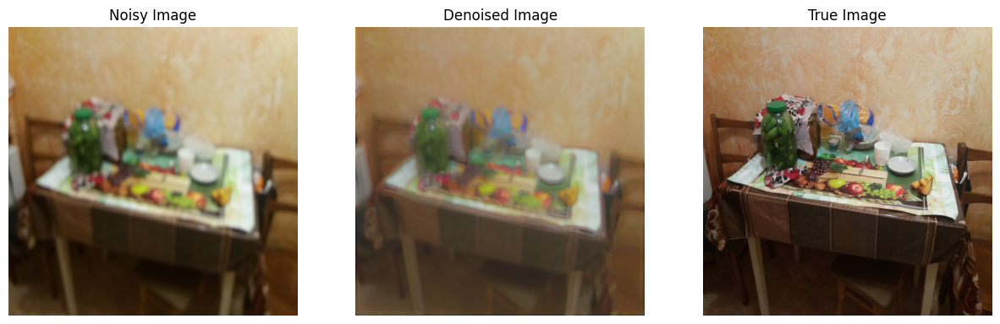

Noisy PSNR: 29.38
Noisy SSIM: 0.5544
Gen PSNR: 27.951520032141254
Gen SSIM: 0.5046031841061134
Noisy PSNR: 27.88
Noisy SSIM: 0.4016
Gen PSNR: 27.97040303352862
Gen SSIM: 0.4293462294365647
Noisy PSNR: 29.59
Noisy SSIM: 0.6366
Gen PSNR: 28.647457198768855
Gen SSIM: 0.6585348064811599
Noisy PSNR: 27.96
Noisy SSIM: 0.4321
Gen PSNR: 27.776422807219028
Gen SSIM: 0.4790114187920677
Noisy PSNR: 29.54
Noisy SSIM: 0.4147
Gen PSNR: 28.35622129849817
Gen SSIM: 0.4142125827202432
Noisy PSNR: 27.88
Noisy SSIM: 0.3691
Gen PSNR: 27.93200898704523
Gen SSIM: 0.39354195000168163
Noisy PSNR: 30.52
Noisy SSIM: 0.5733
Gen PSNR: 28.940928576204804
Gen SSIM: 0.5738805550598305
Noisy PSNR: 27.91
Noisy SSIM: 0.2882
Gen PSNR: 27.875045683415284
Gen SSIM: 0.3196063832109994
Noisy PSNR: 28.59
Noisy SSIM: 0.2621
Gen PSNR: 28.05872532361726
Gen SSIM: 0.269567244123448
Noisy PSNR: 27.86
Noisy SSIM: 0.4202
Gen PSNR: 27.883013753954543
Gen SSIM: 0.48243432003346887
Noisy PSNR: 29.65
Noisy SSIM: 0.4150
Gen PSNR: 27.898

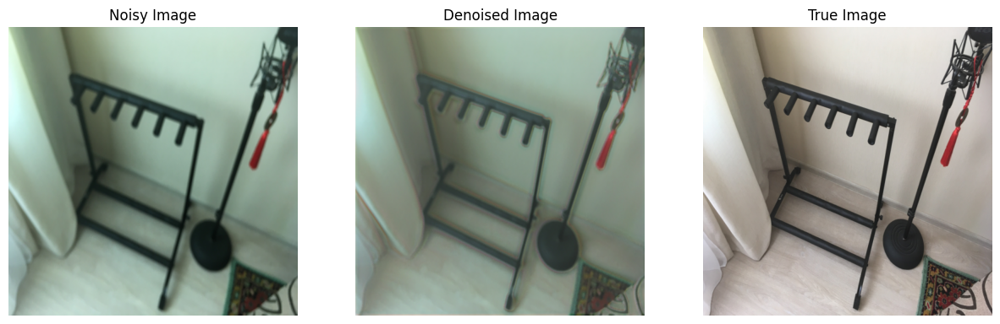

Noisy PSNR: 28.17
Noisy SSIM: 0.7236
Gen PSNR: 27.71882040297026
Gen SSIM: 0.7012338149614917


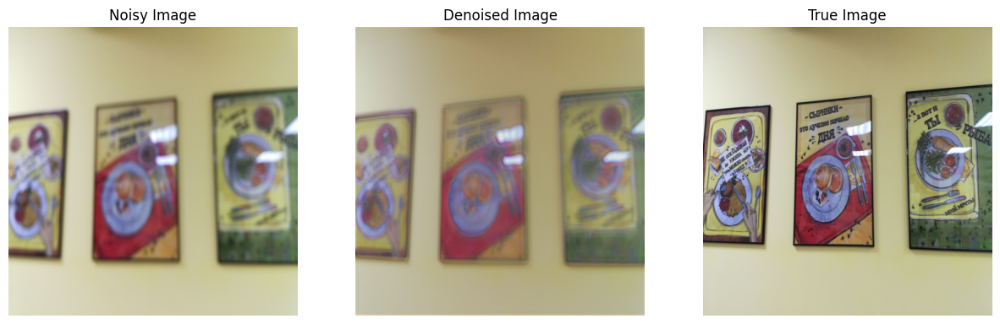

Noisy PSNR: 29.43
Noisy SSIM: 0.5627
Gen PSNR: 27.885274521419205
Gen SSIM: 0.5801587661014921
Noisy PSNR: 27.96
Noisy SSIM: 0.3307
Gen PSNR: 27.89794689947962
Gen SSIM: 0.3649001659146733
Noisy PSNR: 29.57
Noisy SSIM: 0.6596
Gen PSNR: 27.653944446162665
Gen SSIM: 0.6665075531470933
Noisy PSNR: 29.07
Noisy SSIM: 0.4568
Gen PSNR: 27.844699809538795
Gen SSIM: 0.38777622453394534
Noisy PSNR: 28.24
Noisy SSIM: 0.2594
Gen PSNR: 28.3547239133107
Gen SSIM: 0.324410110271279
Noisy PSNR: 28.02
Noisy SSIM: 0.1300
Gen PSNR: 27.87849715344393
Gen SSIM: 0.13903227311666091
Noisy PSNR: 27.96
Noisy SSIM: 0.0668
Gen PSNR: 27.9107060747589
Gen SSIM: 0.07955350063503047
Noisy PSNR: 28.29
Noisy SSIM: 0.5059
Gen PSNR: 28.0760717240611
Gen SSIM: 0.5271719999796768
Noisy PSNR: 28.54
Noisy SSIM: 0.3934
Gen PSNR: 28.16575504848857
Gen SSIM: 0.40532859858327513
Noisy PSNR: 29.15
Noisy SSIM: 0.4407
Gen PSNR: 27.800389092953584
Gen SSIM: 0.4873976414133477
Noisy PSNR: 32.29
Noisy SSIM: 0.6439
Gen PSNR: 27.755054

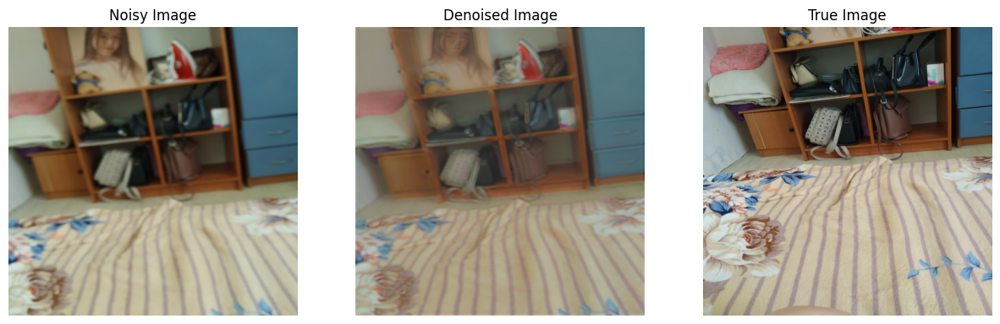

Noisy PSNR: 28.21
Noisy SSIM: 0.3412
Gen PSNR: 27.93898547120042
Gen SSIM: 0.37829565620343875


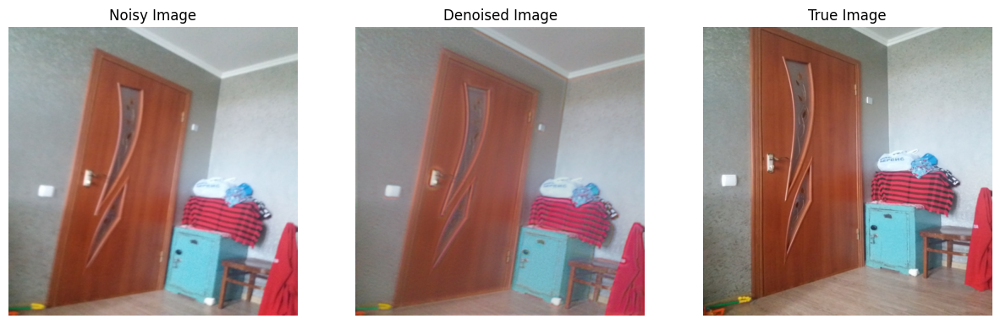

Noisy PSNR: 28.41
Noisy SSIM: 0.5558
Gen PSNR: 28.437223622859953
Gen SSIM: 0.5766500116965728
Noisy PSNR: 28.80
Noisy SSIM: 0.2382
Gen PSNR: 27.863981672839905
Gen SSIM: 0.24092104787247834
Noisy PSNR: 28.26
Noisy SSIM: 0.5951
Gen PSNR: 28.18862920539591
Gen SSIM: 0.5756420931658575
Noisy PSNR: 29.36
Noisy SSIM: 0.4687
Gen PSNR: 28.168629275623633
Gen SSIM: 0.4645669594140675
Noisy PSNR: 28.13
Noisy SSIM: 0.2650
Gen PSNR: 28.04688138738833
Gen SSIM: 0.2861709762743921
Noisy PSNR: 28.12
Noisy SSIM: 0.4693
Gen PSNR: 27.898260430100535
Gen SSIM: 0.43842717787498
Noisy PSNR: 28.06
Noisy SSIM: 0.2090
Gen PSNR: 28.041910717590504
Gen SSIM: 0.24224134373341508
Noisy PSNR: 28.71
Noisy SSIM: 0.7222
Gen PSNR: 28.340301089267538
Gen SSIM: 0.7291881001215744
Noisy PSNR: 28.23
Noisy SSIM: 0.3712
Gen PSNR: 27.97353973477312
Gen SSIM: 0.3910037889957901
Epoch 2/5, Batch 0/70, Loss D: 0.6932, Loss G: 1.4907
Epoch 2/5, Batch 5/70, Loss D: 0.6932, Loss G: 1.7683
Epoch 2/5, Batch 10/70, Loss D: 0.6932, 

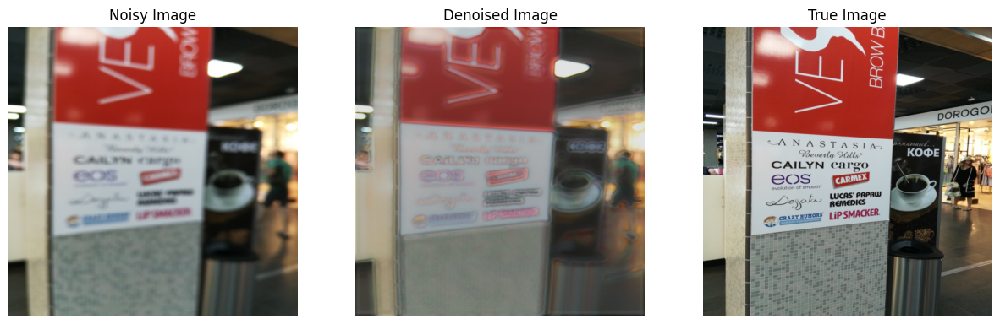

Noisy PSNR: 28.84
Noisy SSIM: 0.3825
Gen PSNR: 28.056482662076903
Gen SSIM: 0.3903309428987785


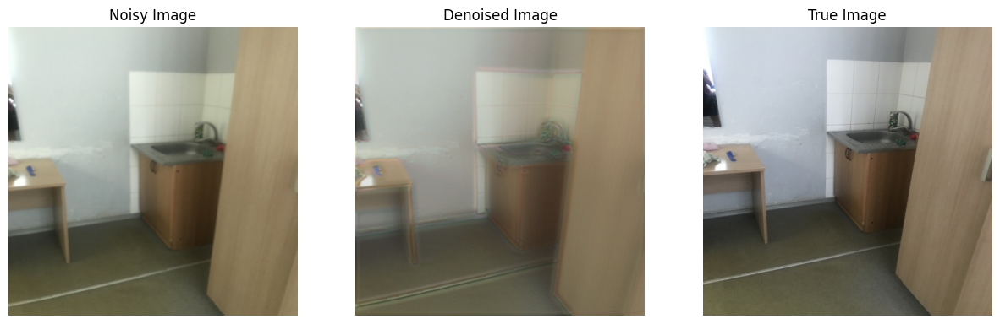

Noisy PSNR: 29.17
Noisy SSIM: 0.7758
Gen PSNR: 29.185740008846057
Gen SSIM: 0.7789781538130076
Noisy PSNR: 28.28
Noisy SSIM: 0.3978
Gen PSNR: 28.094988231002414
Gen SSIM: 0.43534340959274614
Noisy PSNR: 27.80
Noisy SSIM: 0.5134
Gen PSNR: 28.145388216703182
Gen SSIM: 0.5496854135705271
Noisy PSNR: 28.55
Noisy SSIM: 0.2449
Gen PSNR: 28.169122807353546
Gen SSIM: 0.2535004343241286
Noisy PSNR: 28.11
Noisy SSIM: 0.5435
Gen PSNR: 28.223286144494402
Gen SSIM: 0.5424709300612957
Noisy PSNR: 28.09
Noisy SSIM: 0.1732
Gen PSNR: 27.878112728182312
Gen SSIM: 0.16772218319165758
Noisy PSNR: 28.34
Noisy SSIM: 0.6133
Gen PSNR: 28.58103559542726
Gen SSIM: 0.6357604531750086
Noisy PSNR: 28.39
Noisy SSIM: 0.4136
Gen PSNR: 27.91599674693503
Gen SSIM: 0.4130712864538038
Noisy PSNR: 27.89
Noisy SSIM: 0.6561
Gen PSNR: 28.041918887386302
Gen SSIM: 0.6739942460278496
Noisy PSNR: 28.04
Noisy SSIM: 0.6855
Gen PSNR: 27.892520126622976
Gen SSIM: 0.6933144791388052
Noisy PSNR: 28.78
Noisy SSIM: 0.5887
Gen PSNR: 28.

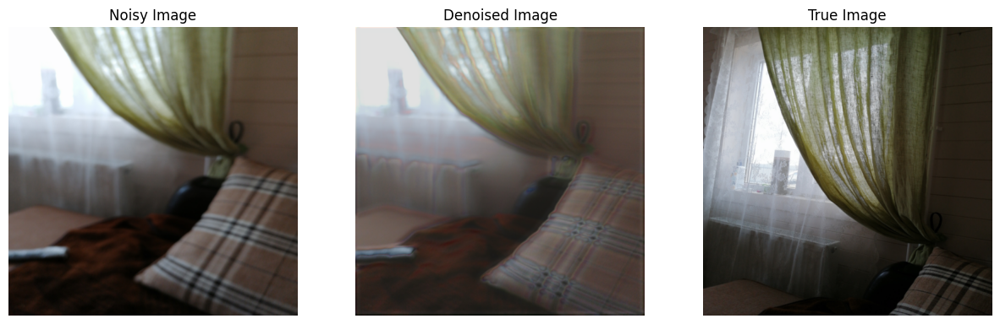

Noisy PSNR: 27.89
Noisy SSIM: 0.3727
Gen PSNR: 27.878609131907282
Gen SSIM: 0.4246137425887591


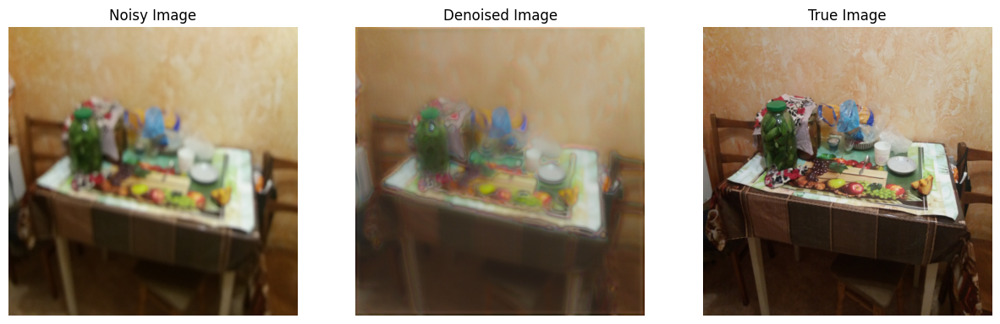

Noisy PSNR: 29.38
Noisy SSIM: 0.5544
Gen PSNR: 27.904911038507866
Gen SSIM: 0.5293214927939532
Noisy PSNR: 27.88
Noisy SSIM: 0.4016
Gen PSNR: 27.883807139854152
Gen SSIM: 0.41917234392728386
Noisy PSNR: 29.59
Noisy SSIM: 0.6366
Gen PSNR: 28.763042510085725
Gen SSIM: 0.6513394027630389
Noisy PSNR: 27.96
Noisy SSIM: 0.4321
Gen PSNR: 27.74932474713062
Gen SSIM: 0.47187236807629124
Noisy PSNR: 29.54
Noisy SSIM: 0.4147
Gen PSNR: 28.633622402446047
Gen SSIM: 0.4196920775575615
Noisy PSNR: 27.88
Noisy SSIM: 0.3691
Gen PSNR: 27.982893106513078
Gen SSIM: 0.3917760159640982
Noisy PSNR: 30.52
Noisy SSIM: 0.5733
Gen PSNR: 28.983714788849475
Gen SSIM: 0.5705400766683487
Noisy PSNR: 27.91
Noisy SSIM: 0.2882
Gen PSNR: 27.867523265108737
Gen SSIM: 0.31975255890199367
Noisy PSNR: 28.59
Noisy SSIM: 0.2621
Gen PSNR: 28.133322249747795
Gen SSIM: 0.2685139574639294
Noisy PSNR: 27.86
Noisy SSIM: 0.4202
Gen PSNR: 27.93772838756069
Gen SSIM: 0.47000946641938063
Noisy PSNR: 29.65
Noisy SSIM: 0.4150
Gen PSNR: 2

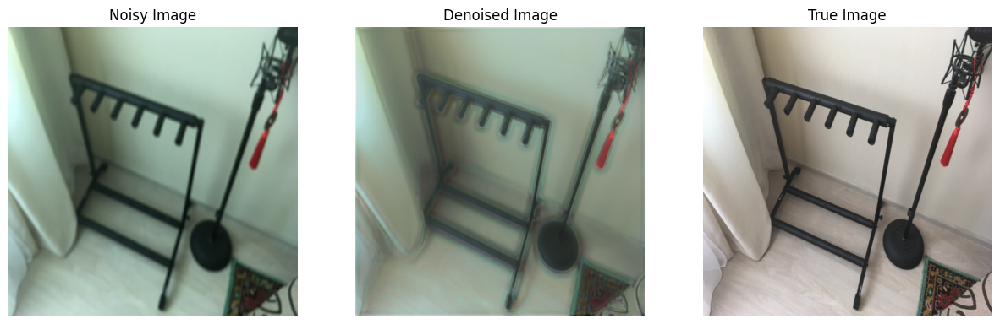

Noisy PSNR: 28.17
Noisy SSIM: 0.7236
Gen PSNR: 27.683421585689608
Gen SSIM: 0.6885977737684775


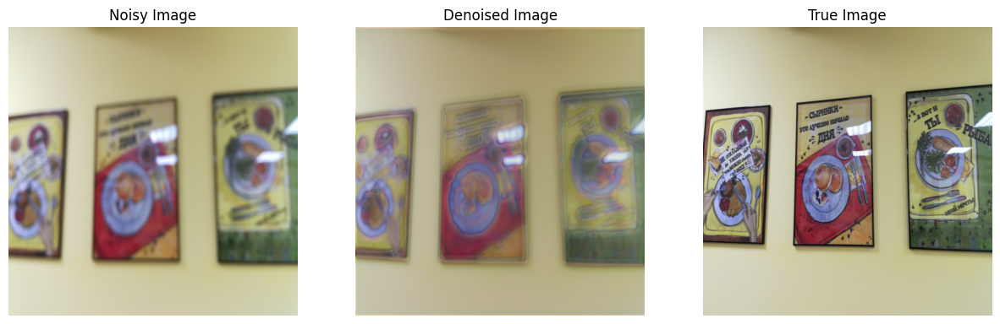

Noisy PSNR: 29.43
Noisy SSIM: 0.5627
Gen PSNR: 27.92689041523797
Gen SSIM: 0.5776175918082379
Noisy PSNR: 27.96
Noisy SSIM: 0.3307
Gen PSNR: 27.938927191955088
Gen SSIM: 0.3631412254105413
Noisy PSNR: 29.57
Noisy SSIM: 0.6596
Gen PSNR: 27.814446719696274
Gen SSIM: 0.6723252986291454
Noisy PSNR: 29.07
Noisy SSIM: 0.4568
Gen PSNR: 27.833485365716758
Gen SSIM: 0.40888318626487746
Noisy PSNR: 28.24
Noisy SSIM: 0.2594
Gen PSNR: 28.387036122137626
Gen SSIM: 0.3156511561524809
Noisy PSNR: 28.02
Noisy SSIM: 0.1300
Gen PSNR: 27.891119693687656
Gen SSIM: 0.13852001886068332
Noisy PSNR: 27.96
Noisy SSIM: 0.0668
Gen PSNR: 27.908852314017008
Gen SSIM: 0.0821887851070212
Noisy PSNR: 28.29
Noisy SSIM: 0.5059
Gen PSNR: 28.17515032278721
Gen SSIM: 0.5315181390804963
Noisy PSNR: 28.54
Noisy SSIM: 0.3934
Gen PSNR: 28.229235702727763
Gen SSIM: 0.4079002487478145
Noisy PSNR: 29.15
Noisy SSIM: 0.4407
Gen PSNR: 27.929186322894143
Gen SSIM: 0.4819649033726918
Noisy PSNR: 32.29
Noisy SSIM: 0.6439
Gen PSNR: 27.

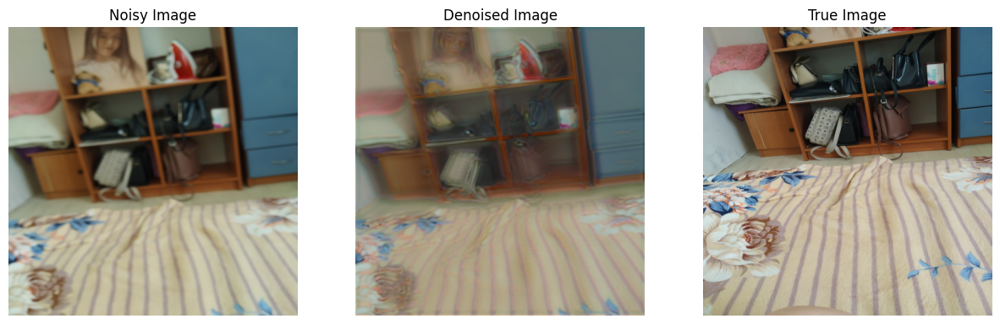

Noisy PSNR: 28.21
Noisy SSIM: 0.3412
Gen PSNR: 27.92716235910661
Gen SSIM: 0.3848044275088302


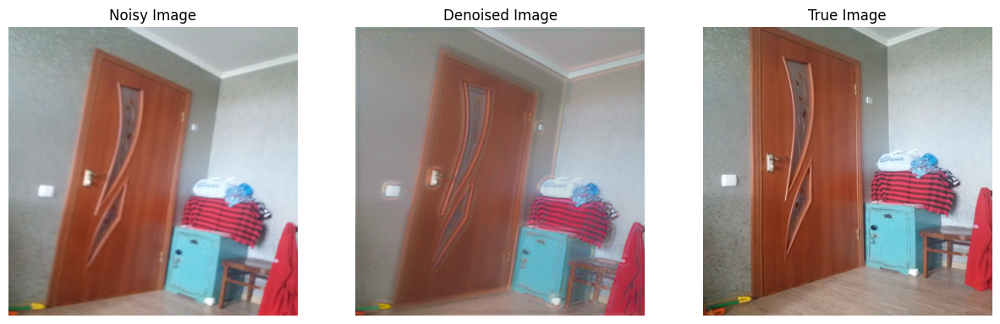

Noisy PSNR: 28.41
Noisy SSIM: 0.5558
Gen PSNR: 28.367224418970707
Gen SSIM: 0.566989412844624
Noisy PSNR: 28.80
Noisy SSIM: 0.2382
Gen PSNR: 27.917995846682537
Gen SSIM: 0.2440851313839868
Noisy PSNR: 28.26
Noisy SSIM: 0.5951
Gen PSNR: 28.241316291806694
Gen SSIM: 0.5644799603556415
Noisy PSNR: 29.36
Noisy SSIM: 0.4687
Gen PSNR: 28.190190702809666
Gen SSIM: 0.4745661422291152
Noisy PSNR: 28.13
Noisy SSIM: 0.2650
Gen PSNR: 28.084575282356795
Gen SSIM: 0.2883965686514434
Noisy PSNR: 28.12
Noisy SSIM: 0.4693
Gen PSNR: 27.9498734118857
Gen SSIM: 0.4501817235415841
Noisy PSNR: 28.06
Noisy SSIM: 0.2090
Gen PSNR: 28.014648343028004
Gen SSIM: 0.23804715215267525
Noisy PSNR: 28.71
Noisy SSIM: 0.7222
Gen PSNR: 28.641973588653222
Gen SSIM: 0.7282229551210188
Noisy PSNR: 28.23
Noisy SSIM: 0.3712
Gen PSNR: 27.97484899633643
Gen SSIM: 0.3913770877159974
Epoch 3/5, Batch 0/70, Loss D: 0.6931, Loss G: 2.0317
Epoch 3/5, Batch 5/70, Loss D: 0.6931, Loss G: 1.5452
Epoch 3/5, Batch 10/70, Loss D: 0.6932, 

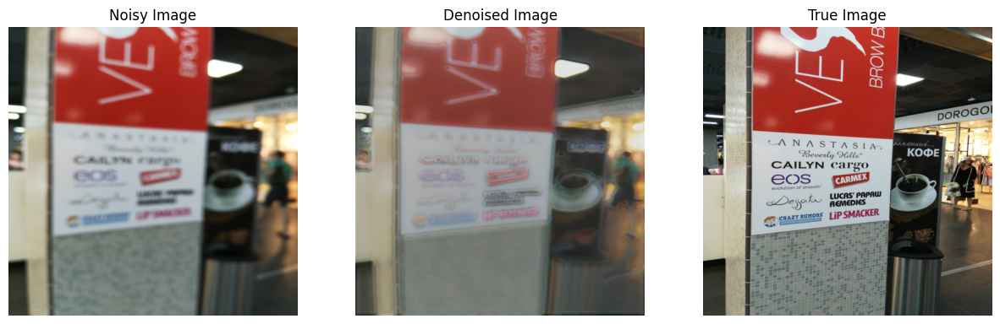

Noisy PSNR: 28.84
Noisy SSIM: 0.3825
Gen PSNR: 27.954428095682605
Gen SSIM: 0.38937251363359543


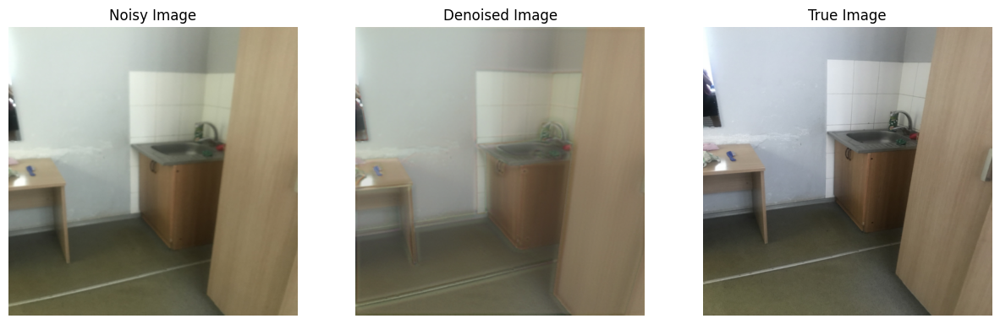

Noisy PSNR: 29.17
Noisy SSIM: 0.7758
Gen PSNR: 29.099562816681136
Gen SSIM: 0.7807040152932183
Noisy PSNR: 28.28
Noisy SSIM: 0.3978
Gen PSNR: 28.069350210733866
Gen SSIM: 0.4347924942015899
Noisy PSNR: 27.80
Noisy SSIM: 0.5134
Gen PSNR: 28.19122982919163
Gen SSIM: 0.5524791711896135
Noisy PSNR: 28.55
Noisy SSIM: 0.2449
Gen PSNR: 28.03198225634341
Gen SSIM: 0.24303735829966464
Noisy PSNR: 28.11
Noisy SSIM: 0.5435
Gen PSNR: 28.185281801441214
Gen SSIM: 0.5435731948981001
Noisy PSNR: 28.09
Noisy SSIM: 0.1732
Gen PSNR: 27.85724095224523
Gen SSIM: 0.16512737444885003
Noisy PSNR: 28.34
Noisy SSIM: 0.6133
Gen PSNR: 28.507787884506513
Gen SSIM: 0.6358637889656137
Noisy PSNR: 28.39
Noisy SSIM: 0.4136
Gen PSNR: 27.892346994976997
Gen SSIM: 0.3988244635986457
Noisy PSNR: 27.89
Noisy SSIM: 0.6561
Gen PSNR: 28.456416645567295
Gen SSIM: 0.680365790190074
Noisy PSNR: 28.04
Noisy SSIM: 0.6855
Gen PSNR: 27.907346994489977
Gen SSIM: 0.700764337857995
Noisy PSNR: 28.78
Noisy SSIM: 0.5887
Gen PSNR: 27.898

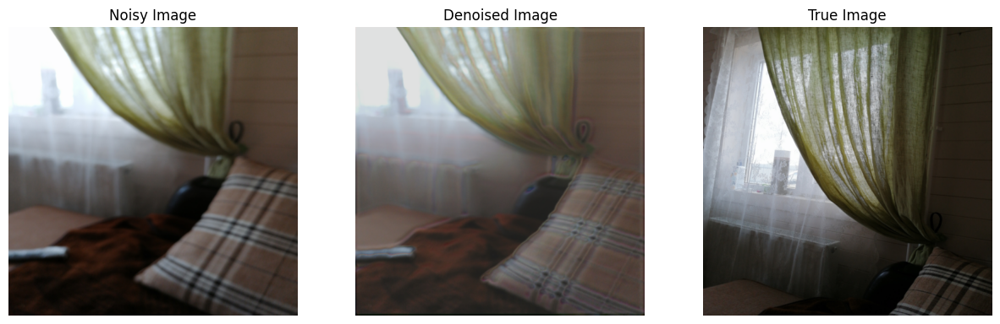

Noisy PSNR: 27.89
Noisy SSIM: 0.3727
Gen PSNR: 27.83998842911525
Gen SSIM: 0.41659350102478804


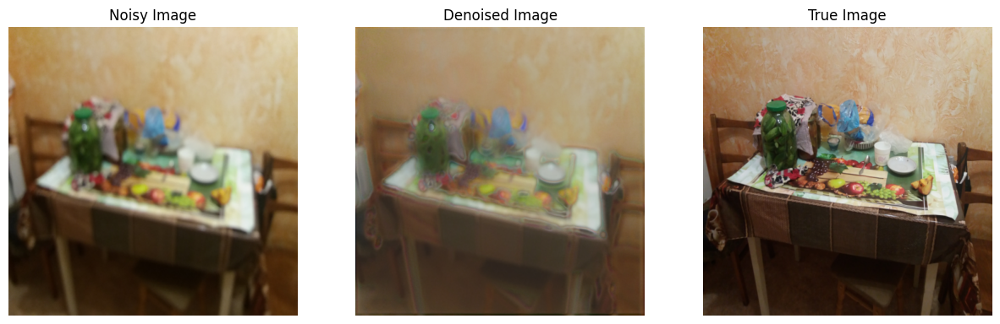

Noisy PSNR: 29.38
Noisy SSIM: 0.5544
Gen PSNR: 27.95160338637573
Gen SSIM: 0.5056441341660428
Noisy PSNR: 27.88
Noisy SSIM: 0.4016
Gen PSNR: 27.915697226726557
Gen SSIM: 0.4205646329475534
Noisy PSNR: 29.59
Noisy SSIM: 0.6366
Gen PSNR: 28.833540470821028
Gen SSIM: 0.6573810204709786
Noisy PSNR: 27.96
Noisy SSIM: 0.4321
Gen PSNR: 27.783065253171245
Gen SSIM: 0.47681505689750514
Noisy PSNR: 29.54
Noisy SSIM: 0.4147
Gen PSNR: 28.433403950537738
Gen SSIM: 0.41536421304209764
Noisy PSNR: 27.88
Noisy SSIM: 0.3691
Gen PSNR: 27.964897458762977
Gen SSIM: 0.3925647579223596
Noisy PSNR: 30.52
Noisy SSIM: 0.5733
Gen PSNR: 29.01011722701594
Gen SSIM: 0.5696504772347107
Noisy PSNR: 27.91
Noisy SSIM: 0.2882
Gen PSNR: 27.857154567402524
Gen SSIM: 0.32175846310443706
Noisy PSNR: 28.59
Noisy SSIM: 0.2621
Gen PSNR: 28.072668854518938
Gen SSIM: 0.2706337788604299
Noisy PSNR: 27.86
Noisy SSIM: 0.4202
Gen PSNR: 27.845314804331117
Gen SSIM: 0.4774693245833486
Noisy PSNR: 29.65
Noisy SSIM: 0.4150
Gen PSNR: 27

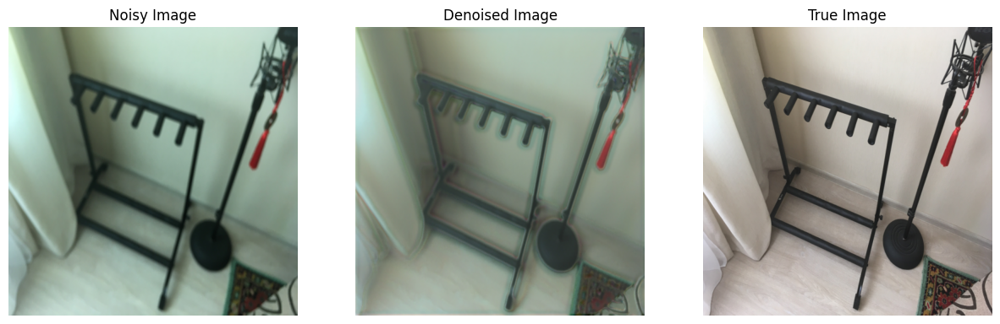

Noisy PSNR: 28.17
Noisy SSIM: 0.7236
Gen PSNR: 27.63779870867601
Gen SSIM: 0.6924418266415121


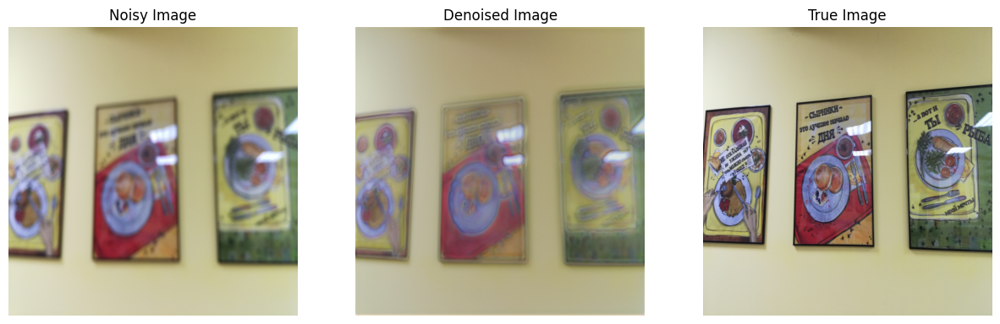

Noisy PSNR: 29.43
Noisy SSIM: 0.5627
Gen PSNR: 28.022113980121638
Gen SSIM: 0.5775338815816133
Noisy PSNR: 27.96
Noisy SSIM: 0.3307
Gen PSNR: 27.922197864371828
Gen SSIM: 0.36381979219716715
Noisy PSNR: 29.57
Noisy SSIM: 0.6596
Gen PSNR: 27.743599272271084
Gen SSIM: 0.6758679758253061
Noisy PSNR: 29.07
Noisy SSIM: 0.4568
Gen PSNR: 27.85229800332303
Gen SSIM: 0.39249633459477606
Noisy PSNR: 28.24
Noisy SSIM: 0.2594
Gen PSNR: 28.376974146670477
Gen SSIM: 0.3334572448314643
Noisy PSNR: 28.02
Noisy SSIM: 0.1300
Gen PSNR: 27.894859021076908
Gen SSIM: 0.13967160862941705
Noisy PSNR: 27.96
Noisy SSIM: 0.0668
Gen PSNR: 27.911736925597033
Gen SSIM: 0.08207582257060952
Noisy PSNR: 28.29
Noisy SSIM: 0.5059
Gen PSNR: 28.100655458755448
Gen SSIM: 0.5318017304319762
Noisy PSNR: 28.54
Noisy SSIM: 0.3934
Gen PSNR: 28.14582613740212
Gen SSIM: 0.4084357225461228
Noisy PSNR: 29.15
Noisy SSIM: 0.4407
Gen PSNR: 27.9219370730237
Gen SSIM: 0.4884289380159084
Noisy PSNR: 32.29
Noisy SSIM: 0.6439
Gen PSNR: 27.

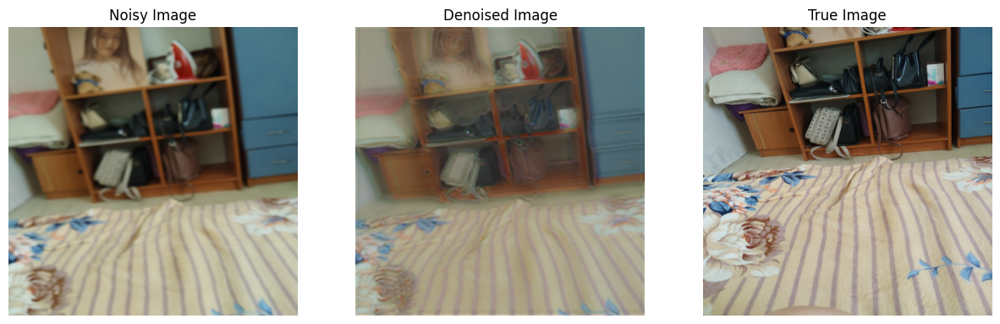

Noisy PSNR: 28.21
Noisy SSIM: 0.3412
Gen PSNR: 27.95159188731755
Gen SSIM: 0.387499232909426


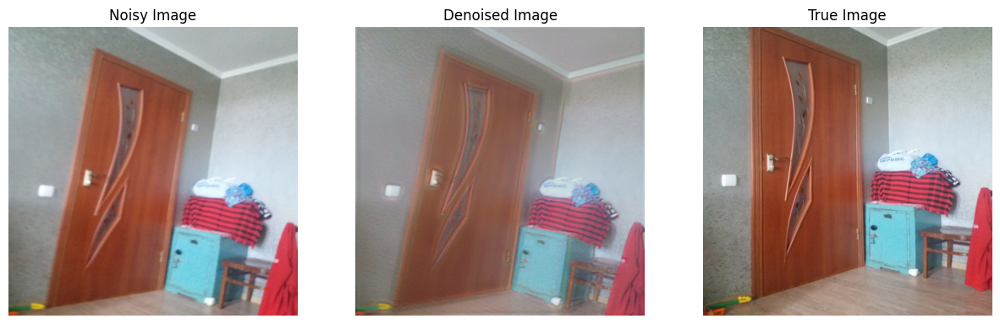

Noisy PSNR: 28.41
Noisy SSIM: 0.5558
Gen PSNR: 28.329583127791462
Gen SSIM: 0.57549312477789
Noisy PSNR: 28.80
Noisy SSIM: 0.2382
Gen PSNR: 28.0522958337141
Gen SSIM: 0.24693919832408506
Noisy PSNR: 28.26
Noisy SSIM: 0.5951
Gen PSNR: 28.07651361783195
Gen SSIM: 0.5735103639454486
Noisy PSNR: 29.36
Noisy SSIM: 0.4687
Gen PSNR: 28.207441090348023
Gen SSIM: 0.4674359824347422
Noisy PSNR: 28.13
Noisy SSIM: 0.2650
Gen PSNR: 28.054102367291485
Gen SSIM: 0.29006303376004144
Noisy PSNR: 28.12
Noisy SSIM: 0.4693
Gen PSNR: 27.927086006551086
Gen SSIM: 0.4434790194444837
Noisy PSNR: 28.06
Noisy SSIM: 0.2090
Gen PSNR: 28.01931989279025
Gen SSIM: 0.24241894984467252
Noisy PSNR: 28.71
Noisy SSIM: 0.7222
Gen PSNR: 28.81584202781105
Gen SSIM: 0.7318006694803043
Noisy PSNR: 28.23
Noisy SSIM: 0.3712
Gen PSNR: 27.996511428732376
Gen SSIM: 0.3893436370770928
Epoch 4/5, Batch 0/70, Loss D: 0.6931, Loss G: 1.7167
Epoch 4/5, Batch 5/70, Loss D: 0.6931, Loss G: 1.8029
Epoch 4/5, Batch 10/70, Loss D: 0.6931, L

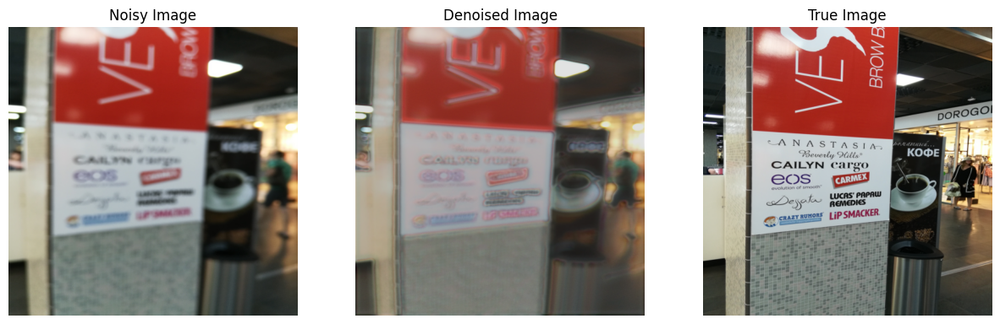

Noisy PSNR: 28.84
Noisy SSIM: 0.3825
Gen PSNR: 28.098817838966085
Gen SSIM: 0.39167055851080085


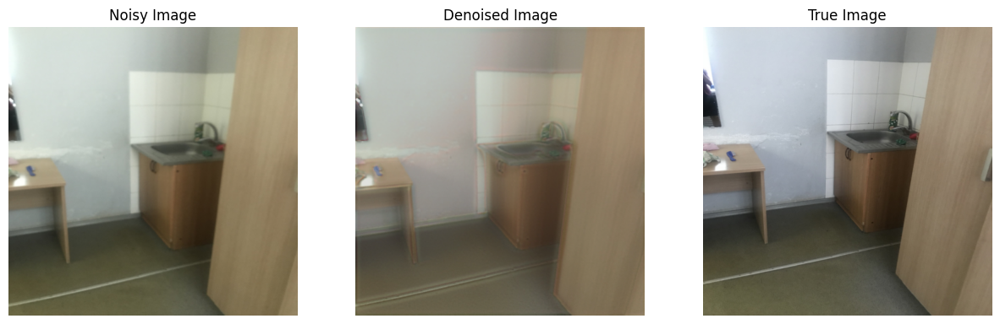

Noisy PSNR: 29.17
Noisy SSIM: 0.7758
Gen PSNR: 29.022929676354853
Gen SSIM: 0.7824059188852369
Noisy PSNR: 28.28
Noisy SSIM: 0.3978
Gen PSNR: 28.08335919532783
Gen SSIM: 0.4393338803406667
Noisy PSNR: 27.80
Noisy SSIM: 0.5134
Gen PSNR: 28.110756308525776
Gen SSIM: 0.5522195350540023
Noisy PSNR: 28.55
Noisy SSIM: 0.2449
Gen PSNR: 28.14191008058956
Gen SSIM: 0.2506553165375575
Noisy PSNR: 28.11
Noisy SSIM: 0.5435
Gen PSNR: 28.1769008136426
Gen SSIM: 0.5484143907678662
Noisy PSNR: 28.09
Noisy SSIM: 0.1732
Gen PSNR: 27.86834460088307
Gen SSIM: 0.16830875284498104
Noisy PSNR: 28.34
Noisy SSIM: 0.6133
Gen PSNR: 28.606088393735472
Gen SSIM: 0.6434089350451921
Noisy PSNR: 28.39
Noisy SSIM: 0.4136
Gen PSNR: 27.8914160079923
Gen SSIM: 0.41378708395515956
Noisy PSNR: 27.89
Noisy SSIM: 0.6561
Gen PSNR: 28.376853344531284
Gen SSIM: 0.6789264571306303
Noisy PSNR: 28.04
Noisy SSIM: 0.6855
Gen PSNR: 27.894769792649008
Gen SSIM: 0.6967515081983517
Noisy PSNR: 28.78
Noisy SSIM: 0.5887
Gen PSNR: 28.04062

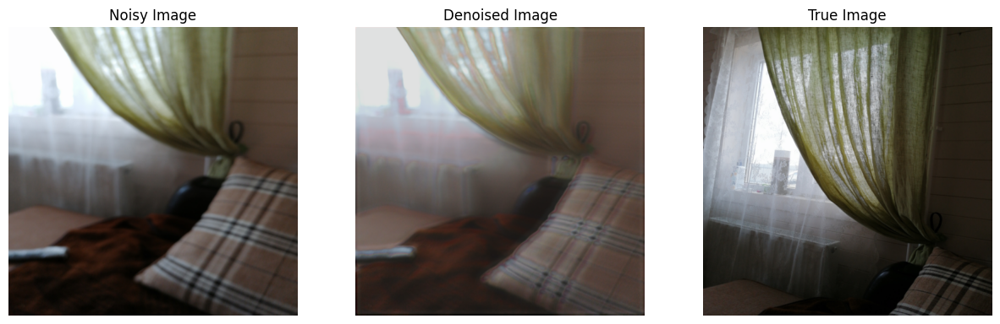

Noisy PSNR: 27.89
Noisy SSIM: 0.3727
Gen PSNR: 27.868078342374506
Gen SSIM: 0.422068870299188


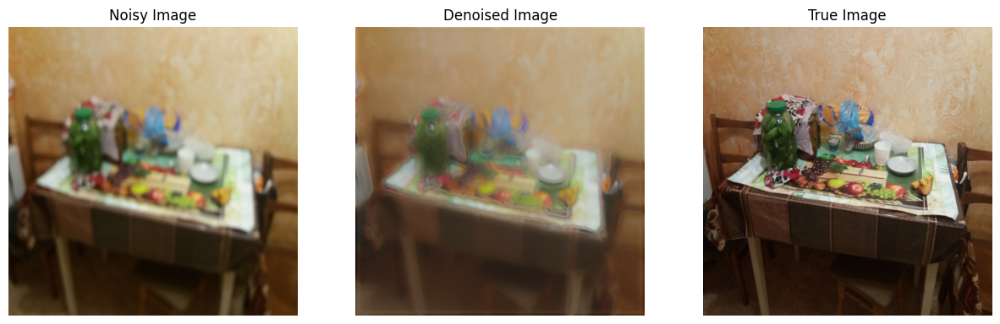

Noisy PSNR: 29.38
Noisy SSIM: 0.5544
Gen PSNR: 27.9861518148795
Gen SSIM: 0.5256420535373979
Noisy PSNR: 27.88
Noisy SSIM: 0.4016
Gen PSNR: 27.93524830619516
Gen SSIM: 0.4247309715927443
Noisy PSNR: 29.59
Noisy SSIM: 0.6366
Gen PSNR: 28.95919619532309
Gen SSIM: 0.6592806698927561
Noisy PSNR: 27.96
Noisy SSIM: 0.4321
Gen PSNR: 27.773511657295966
Gen SSIM: 0.4790047073410779
Noisy PSNR: 29.54
Noisy SSIM: 0.4147
Gen PSNR: 28.45162394373348
Gen SSIM: 0.4215493554287029
Noisy PSNR: 27.88
Noisy SSIM: 0.3691
Gen PSNR: 27.9947426034271
Gen SSIM: 0.39746554850696025
Noisy PSNR: 30.52
Noisy SSIM: 0.5733
Gen PSNR: 28.9910321934983
Gen SSIM: 0.5678251672516196
Noisy PSNR: 27.91
Noisy SSIM: 0.2882
Gen PSNR: 27.84516288310754
Gen SSIM: 0.32277173108062074
Noisy PSNR: 28.59
Noisy SSIM: 0.2621
Gen PSNR: 28.14369258407951
Gen SSIM: 0.27152082434527647
Noisy PSNR: 27.86
Noisy SSIM: 0.4202
Gen PSNR: 27.931012499708604
Gen SSIM: 0.4740159899626759
Noisy PSNR: 29.65
Noisy SSIM: 0.4150
Gen PSNR: 27.88940909

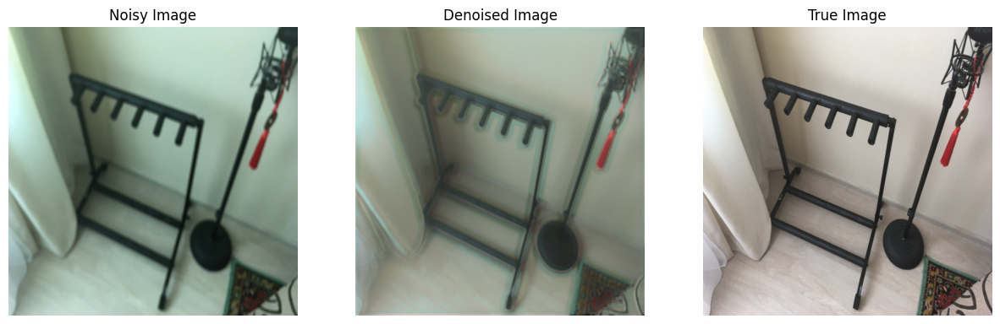

Noisy PSNR: 28.17
Noisy SSIM: 0.7236
Gen PSNR: 27.62934497119772
Gen SSIM: 0.6844687937035925


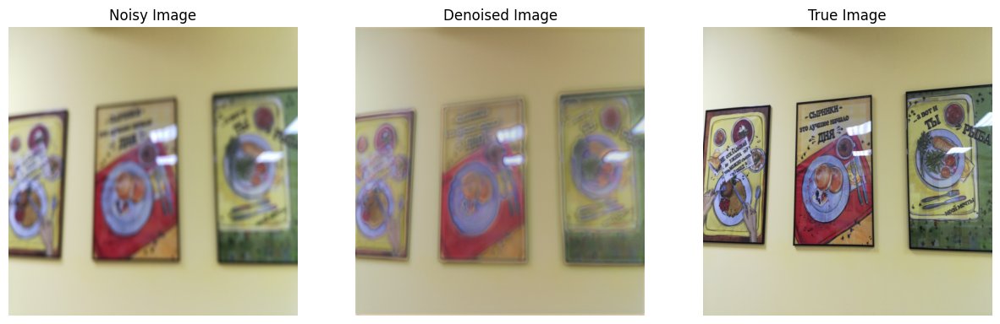

Noisy PSNR: 29.43
Noisy SSIM: 0.5627
Gen PSNR: 28.02844065725662
Gen SSIM: 0.5765338186417106
Noisy PSNR: 27.96
Noisy SSIM: 0.3307
Gen PSNR: 27.950776220752083
Gen SSIM: 0.3640863669430243
Noisy PSNR: 29.57
Noisy SSIM: 0.6596
Gen PSNR: 27.880643171607446
Gen SSIM: 0.6769207376511224
Noisy PSNR: 29.07
Noisy SSIM: 0.4568
Gen PSNR: 27.98435052242951
Gen SSIM: 0.4143424339103204
Noisy PSNR: 28.24
Noisy SSIM: 0.2594
Gen PSNR: 28.33076428376703
Gen SSIM: 0.33182752665601994
Noisy PSNR: 28.02
Noisy SSIM: 0.1300
Gen PSNR: 27.898804896566176
Gen SSIM: 0.14198969412321963
Noisy PSNR: 27.96
Noisy SSIM: 0.0668
Gen PSNR: 27.90848817327867
Gen SSIM: 0.08214192691023263
Noisy PSNR: 28.29
Noisy SSIM: 0.5059
Gen PSNR: 28.083288240116705
Gen SSIM: 0.5344154315399763
Noisy PSNR: 28.54
Noisy SSIM: 0.3934
Gen PSNR: 28.314768545892566
Gen SSIM: 0.41175540033916563
Noisy PSNR: 29.15
Noisy SSIM: 0.4407
Gen PSNR: 28.06064429647723
Gen SSIM: 0.4863493017393146
Noisy PSNR: 32.29
Noisy SSIM: 0.6439
Gen PSNR: 27.7

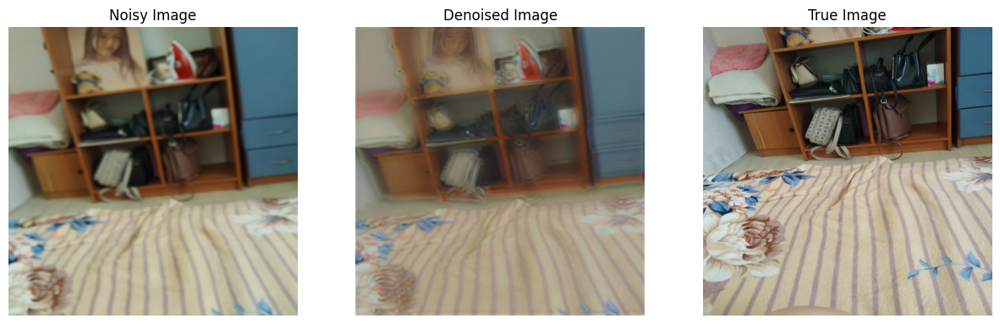

Noisy PSNR: 28.21
Noisy SSIM: 0.3412
Gen PSNR: 27.965177268221236
Gen SSIM: 0.3858753180783398


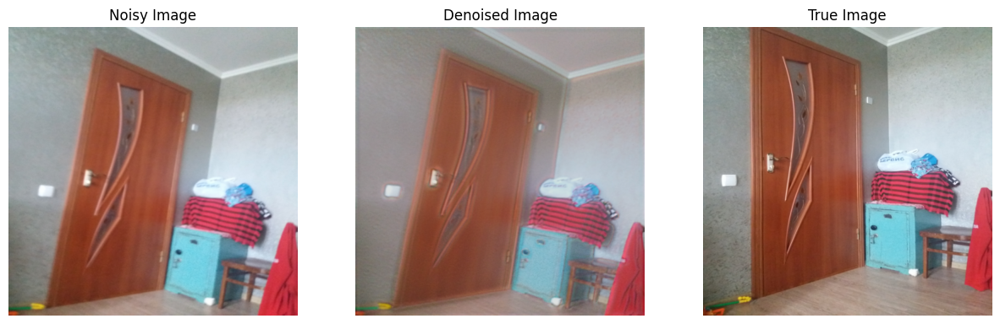

Noisy PSNR: 28.41
Noisy SSIM: 0.5558
Gen PSNR: 28.38865509531045
Gen SSIM: 0.5750540910742851
Noisy PSNR: 28.80
Noisy SSIM: 0.2382
Gen PSNR: 27.86102168668885
Gen SSIM: 0.24762994080600007
Noisy PSNR: 28.26
Noisy SSIM: 0.5951
Gen PSNR: 28.16159979653685
Gen SSIM: 0.5824972472326494
Noisy PSNR: 29.36
Noisy SSIM: 0.4687
Gen PSNR: 28.343712011311446
Gen SSIM: 0.47959239144812127
Noisy PSNR: 28.13
Noisy SSIM: 0.2650
Gen PSNR: 28.08404897971875
Gen SSIM: 0.2908852194830877
Noisy PSNR: 28.12
Noisy SSIM: 0.4693
Gen PSNR: 27.910975799613304
Gen SSIM: 0.4557797593857691
Noisy PSNR: 28.06
Noisy SSIM: 0.2090
Gen PSNR: 28.022685779490008
Gen SSIM: 0.24282529863651603
Noisy PSNR: 28.71
Noisy SSIM: 0.7222
Gen PSNR: 28.59292749966089
Gen SSIM: 0.731428786377796
Noisy PSNR: 28.23
Noisy SSIM: 0.3712
Gen PSNR: 28.022802561640596
Gen SSIM: 0.3909879862812727
Epoch 5/5, Batch 0/70, Loss D: 0.6931, Loss G: 1.7318
Epoch 5/5, Batch 5/70, Loss D: 0.6931, Loss G: 1.4709
Epoch 5/5, Batch 10/70, Loss D: 0.6931, 

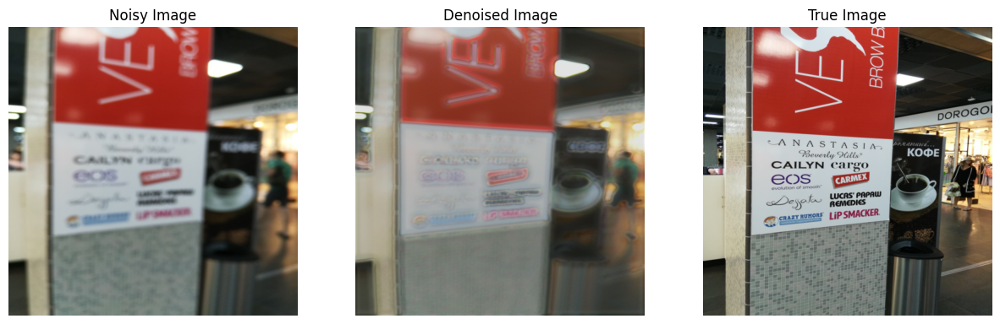

Noisy PSNR: 28.84
Noisy SSIM: 0.3825
Gen PSNR: 28.105876533158593
Gen SSIM: 0.39250888024057234


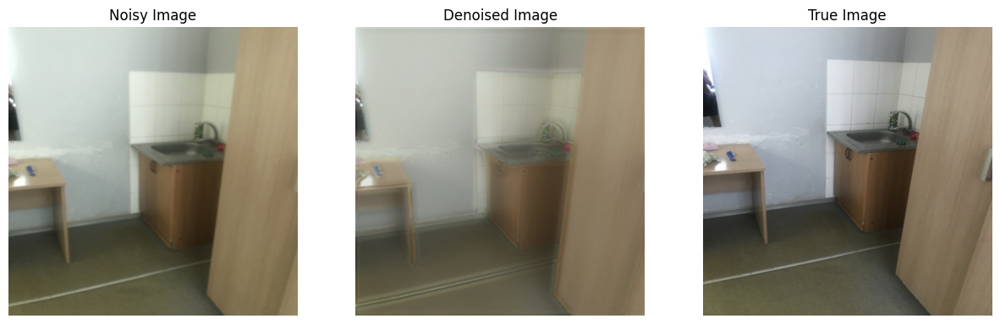

Noisy PSNR: 29.17
Noisy SSIM: 0.7758
Gen PSNR: 29.35778802767058
Gen SSIM: 0.7824047813173821
Noisy PSNR: 28.28
Noisy SSIM: 0.3978
Gen PSNR: 28.148663412630075
Gen SSIM: 0.4403971701066413
Noisy PSNR: 27.80
Noisy SSIM: 0.5134
Gen PSNR: 28.204672732644948
Gen SSIM: 0.5524925088223346
Noisy PSNR: 28.55
Noisy SSIM: 0.2449
Gen PSNR: 28.20648444792522
Gen SSIM: 0.2540480817495193
Noisy PSNR: 28.11
Noisy SSIM: 0.5435
Gen PSNR: 28.522003887178236
Gen SSIM: 0.5472285809172406
Noisy PSNR: 28.09
Noisy SSIM: 0.1732
Gen PSNR: 27.88609321874311
Gen SSIM: 0.1690499406827953
Noisy PSNR: 28.34
Noisy SSIM: 0.6133
Gen PSNR: 28.483126321635332
Gen SSIM: 0.6386373651971777
Noisy PSNR: 28.39
Noisy SSIM: 0.4136
Gen PSNR: 27.889387521882295
Gen SSIM: 0.4207714917630215
Noisy PSNR: 27.89
Noisy SSIM: 0.6561
Gen PSNR: 28.565943153149323
Gen SSIM: 0.6838831352466986
Noisy PSNR: 28.04
Noisy SSIM: 0.6855
Gen PSNR: 27.928887420413233
Gen SSIM: 0.7004288619693014
Noisy PSNR: 28.78
Noisy SSIM: 0.5887
Gen PSNR: 28.002

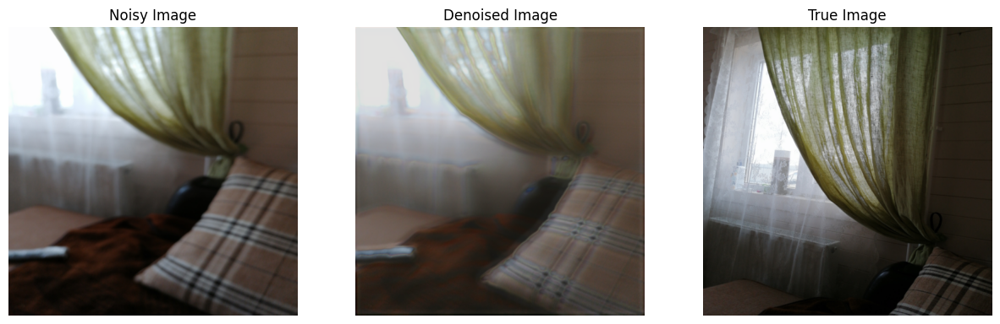

Noisy PSNR: 27.89
Noisy SSIM: 0.3727
Gen PSNR: 27.862113068785206
Gen SSIM: 0.4257410697278237


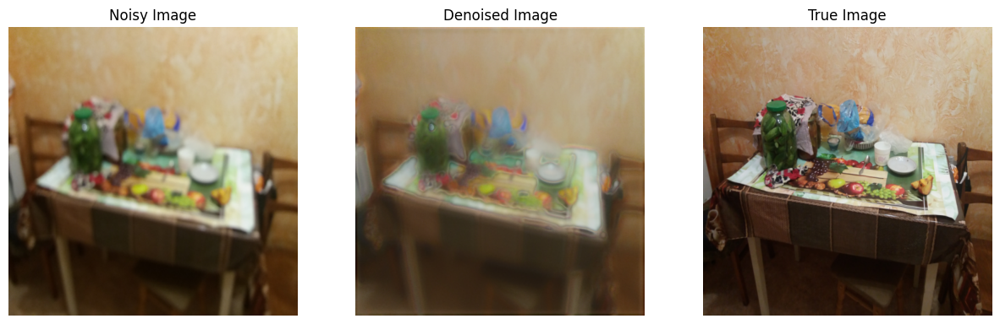

Noisy PSNR: 29.38
Noisy SSIM: 0.5544
Gen PSNR: 28.067022496999485
Gen SSIM: 0.5365018603391369
Noisy PSNR: 27.88
Noisy SSIM: 0.4016
Gen PSNR: 27.90681561691878
Gen SSIM: 0.42422498008202775
Noisy PSNR: 29.59
Noisy SSIM: 0.6366
Gen PSNR: 29.15602104662632
Gen SSIM: 0.6562951700126477
Noisy PSNR: 27.96
Noisy SSIM: 0.4321
Gen PSNR: 27.792042597144373
Gen SSIM: 0.4784499406284804
Noisy PSNR: 29.54
Noisy SSIM: 0.4147
Gen PSNR: 28.727399070585538
Gen SSIM: 0.421977837097162
Noisy PSNR: 27.88
Noisy SSIM: 0.3691
Gen PSNR: 27.976979260780574
Gen SSIM: 0.4004930656912216
Noisy PSNR: 30.52
Noisy SSIM: 0.5733
Gen PSNR: 29.214455167692325
Gen SSIM: 0.5712093763025483
Noisy PSNR: 27.91
Noisy SSIM: 0.2882
Gen PSNR: 27.853279232365253
Gen SSIM: 0.32211883512081935
Noisy PSNR: 28.59
Noisy SSIM: 0.2621
Gen PSNR: 28.047428124459948
Gen SSIM: 0.2739412393809228
Noisy PSNR: 27.86
Noisy SSIM: 0.4202
Gen PSNR: 27.941300418394768
Gen SSIM: 0.4682484256434147
Noisy PSNR: 29.65
Noisy SSIM: 0.4150
Gen PSNR: 27.9

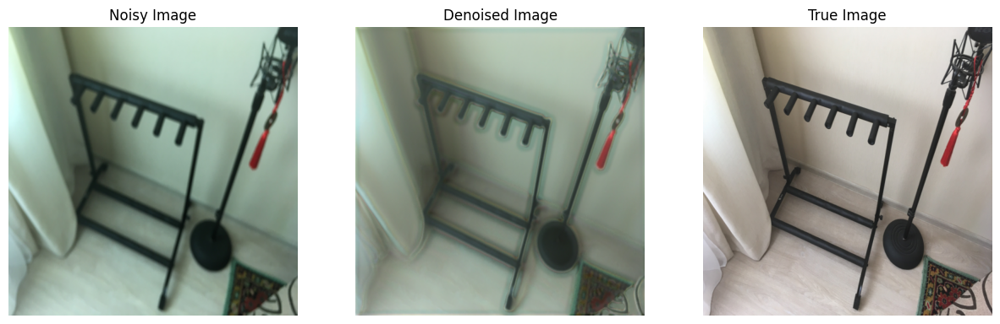

Noisy PSNR: 28.17
Noisy SSIM: 0.7236
Gen PSNR: 27.704363257509907
Gen SSIM: 0.6863002735517342


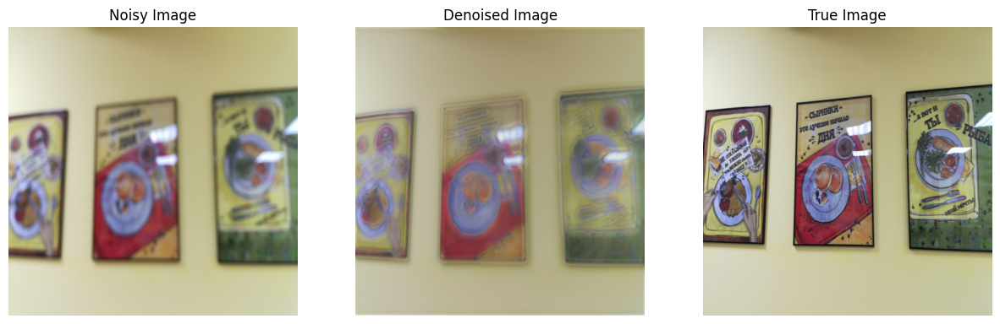

Noisy PSNR: 29.43
Noisy SSIM: 0.5627
Gen PSNR: 28.0337932108924
Gen SSIM: 0.5777042058263208
Noisy PSNR: 27.96
Noisy SSIM: 0.3307
Gen PSNR: 27.964219644055408
Gen SSIM: 0.36413629663001973
Noisy PSNR: 29.57
Noisy SSIM: 0.6596
Gen PSNR: 27.95981783209271
Gen SSIM: 0.679106849925769
Noisy PSNR: 29.07
Noisy SSIM: 0.4568
Gen PSNR: 27.974831202350185
Gen SSIM: 0.42509373266054834
Noisy PSNR: 28.24
Noisy SSIM: 0.2594
Gen PSNR: 28.252670141237644
Gen SSIM: 0.3418947918727521
Noisy PSNR: 28.02
Noisy SSIM: 0.1300
Gen PSNR: 27.92003127161836
Gen SSIM: 0.1427333633756196
Noisy PSNR: 27.96
Noisy SSIM: 0.0668
Gen PSNR: 27.91466433215694
Gen SSIM: 0.0820633076147879
Noisy PSNR: 28.29
Noisy SSIM: 0.5059
Gen PSNR: 28.041963361643543
Gen SSIM: 0.542091110681786
Noisy PSNR: 28.54
Noisy SSIM: 0.3934
Gen PSNR: 28.36212543613962
Gen SSIM: 0.4169648803861968
Noisy PSNR: 29.15
Noisy SSIM: 0.4407
Gen PSNR: 27.9866563427287
Gen SSIM: 0.48838926522158776
Noisy PSNR: 32.29
Noisy SSIM: 0.6439
Gen PSNR: 27.6573953

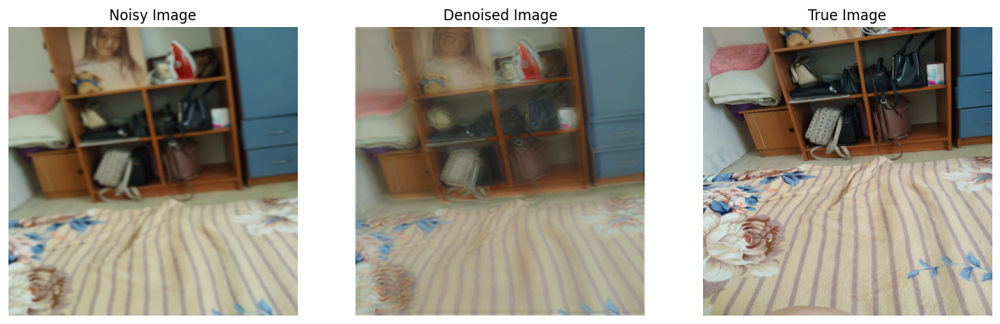

Noisy PSNR: 28.21
Noisy SSIM: 0.3412
Gen PSNR: 28.024761069717144
Gen SSIM: 0.3875576421111289


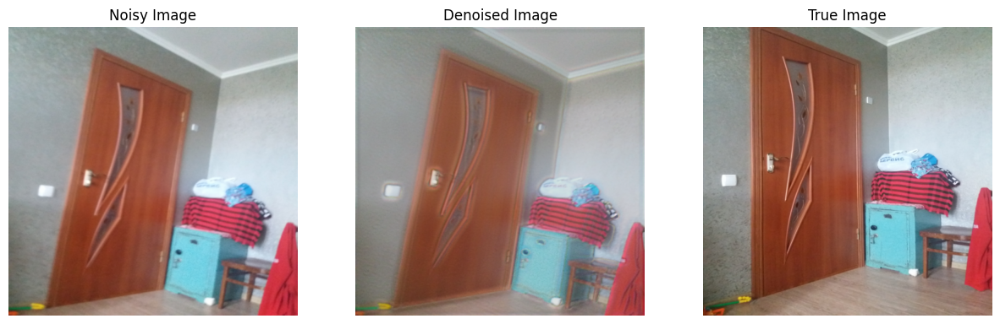

Noisy PSNR: 28.41
Noisy SSIM: 0.5558
Gen PSNR: 28.394611384726687
Gen SSIM: 0.5750917369631022
Noisy PSNR: 28.80
Noisy SSIM: 0.2382
Gen PSNR: 27.915005765543377
Gen SSIM: 0.2480373412164862
Noisy PSNR: 28.26
Noisy SSIM: 0.5951
Gen PSNR: 28.24564880701308
Gen SSIM: 0.5758918325495045
Noisy PSNR: 29.36
Noisy SSIM: 0.4687
Gen PSNR: 28.30342160249266
Gen SSIM: 0.48287749354202364
Noisy PSNR: 28.13
Noisy SSIM: 0.2650
Gen PSNR: 28.087118638521446
Gen SSIM: 0.29134434921359387
Noisy PSNR: 28.12
Noisy SSIM: 0.4693
Gen PSNR: 27.868761643794187
Gen SSIM: 0.457168613111174
Noisy PSNR: 28.06
Noisy SSIM: 0.2090
Gen PSNR: 28.019054710775343
Gen SSIM: 0.24255297615597562
Noisy PSNR: 28.71
Noisy SSIM: 0.7222
Gen PSNR: 28.989052754866552
Gen SSIM: 0.732668792187834
Noisy PSNR: 28.23
Noisy SSIM: 0.3712
Gen PSNR: 28.02250587217456
Gen SSIM: 0.3938012673707166
Mean PSNR Input: 28.6071
Mean SSIM Input: 0.4530
Mean PSNR Gen: 28.1735
Mean RMSE Gen: 0.4700
Metrics saved to metrics.csv


In [60]:
# Define variables
train_folder = '/content/blur_dataset_scaled'  # Path to the folder containing image pairs
num_epochs = 5

# Call the main function
main(train_folder, num_epochs)

In [61]:
import gc
gc.collect()
torch.cuda.empty_cache()